# **Regression Analysis Task:**

**Linear Regression** *– A basic regression technique that models the relationship between dependent and independent variables using a linear equation.*

**Polynomial Regression** *– An extension of linear regression that fits a polynomial equation to capture non-linear relationships.*

**Ridge Regression** *– A regularized version of linear regression that adds an L2 penalty to reduce overfitting.*

**Lasso Regression** – Similar to ridge regression but uses an L1 penalty, which helps with feature selection by shrinking some coefficients to zero. *italicized text*

**Elastic Net Regression** *– A hybrid of ridge and lasso regression that combines both L1 and L2 penalties for better generalization.*

**Support Vector Regression (SVR)** *– A regression approach based on Support Vector Machines (SVM), which aims to find a best-fit hyperplane within a certain margin of tolerance.*

**Decision Tree Regression** *– A non-linear regression model that splits data into branches based on feature values and makes predictions using a tree structure.*

**Neural Network** *– A machine learning model inspired by the human brain, using layers of interconnected nodes to learn patterns from data.*

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
data = pd.read_csv('house_price_regression_dataset.csv')

# Display the first few rows
print(data.head())

# Check the dataset info
print(data.info())

# Check for missing values
print(data.isnull().sum())

   Square_Footage  Num_Bedrooms  Num_Bathrooms  Year_Built  Lot_Size  \
0            1360             2              1        1981  0.599637   
1            4272             3              3        2016  4.753014   
2            3592             1              2        2016  3.634823   
3             966             1              2        1977  2.730667   
4            4926             2              1        1993  4.699073   

   Garage_Size  Neighborhood_Quality   House_Price  
0            0                     5  2.623829e+05  
1            1                     6  9.852609e+05  
2            0                     9  7.779774e+05  
3            1                     8  2.296989e+05  
4            0                     8  1.041741e+06  
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Square_Footage        1000 non-null  

0


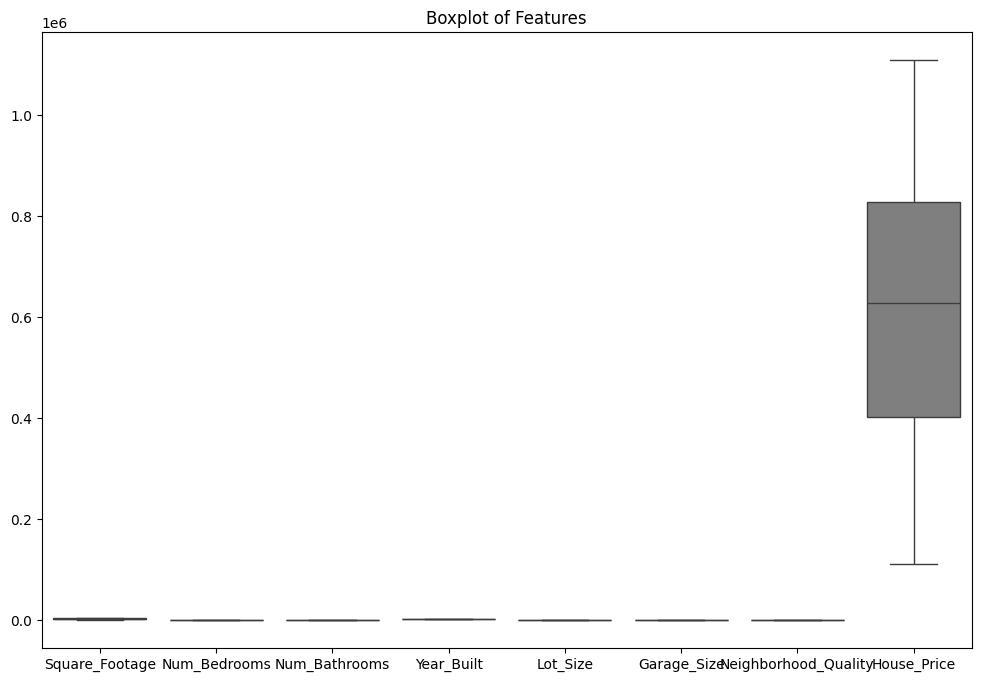

In [6]:
# Handle missing values (if any)
data = data.dropna()  # Drop rows with missing values (if applicable)

# Check for duplicates
print(data.duplicated().sum())

# Remove duplicates (if any)
data = data.drop_duplicates()

# Check for outliers using boxplots
plt.figure(figsize=(12, 8))
sns.boxplot(data=data)
plt.title("Boxplot of Features")
plt.show()

# Handle outliers (if necessary)
# For example, cap outliers at the 99th percentile
for col in data.columns:
    if data[col].dtype != 'object':  # Only for numeric columns
        upper_limit = data[col].quantile(0.99)
        data[col] = np.where(data[col] > upper_limit, upper_limit, data[col])

       Square_Footage  Num_Bedrooms  Num_Bathrooms   Year_Built     Lot_Size  \
count      1000.00000   1000.000000    1000.000000  1000.000000  1000.000000   
mean       2815.33830      2.990000       1.973000  1986.550000     2.777876   
std        1255.36981      1.427564       0.820332    20.632916     1.297547   
min         503.00000      1.000000       1.000000  1950.000000     0.506058   
25%        1749.50000      2.000000       1.000000  1969.000000     1.665946   
50%        2862.50000      3.000000       2.000000  1986.000000     2.809740   
75%        3849.50000      4.000000       3.000000  2004.250000     3.923317   
max        4985.03000      5.000000       3.000000  2022.000000     4.952458   

       Garage_Size  Neighborhood_Quality   House_Price  
count  1000.000000           1000.000000  1.000000e+03  
mean      1.022000              5.615000  6.186395e+05  
std       0.814973              2.887059  2.531614e+05  
min       0.000000              1.000000  1.116269e

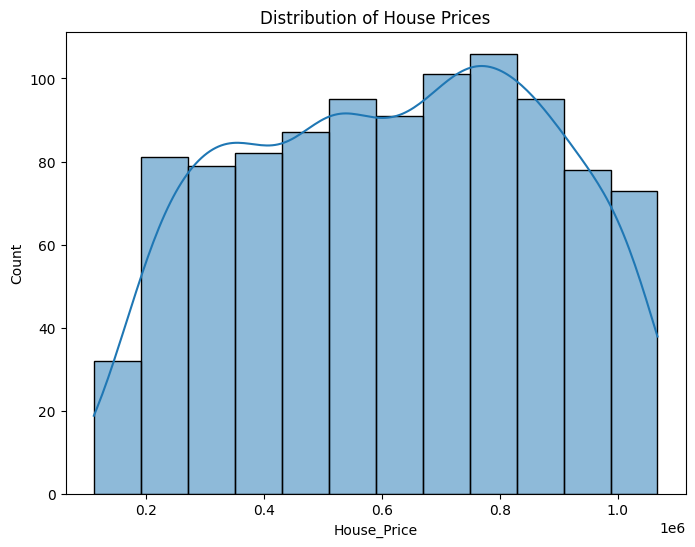

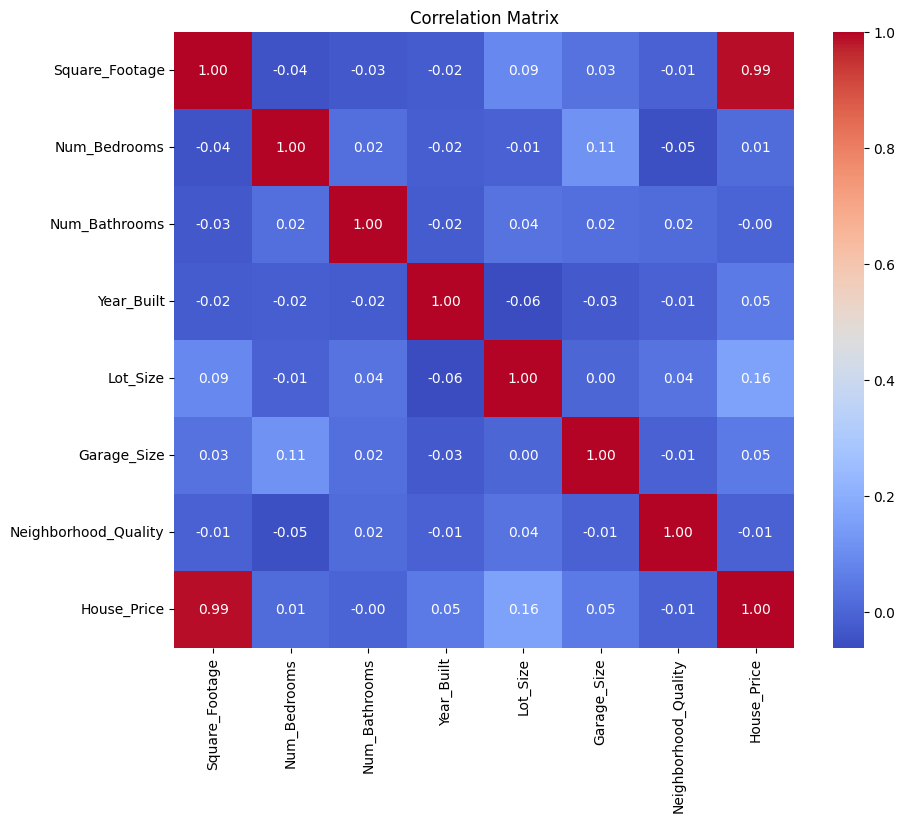

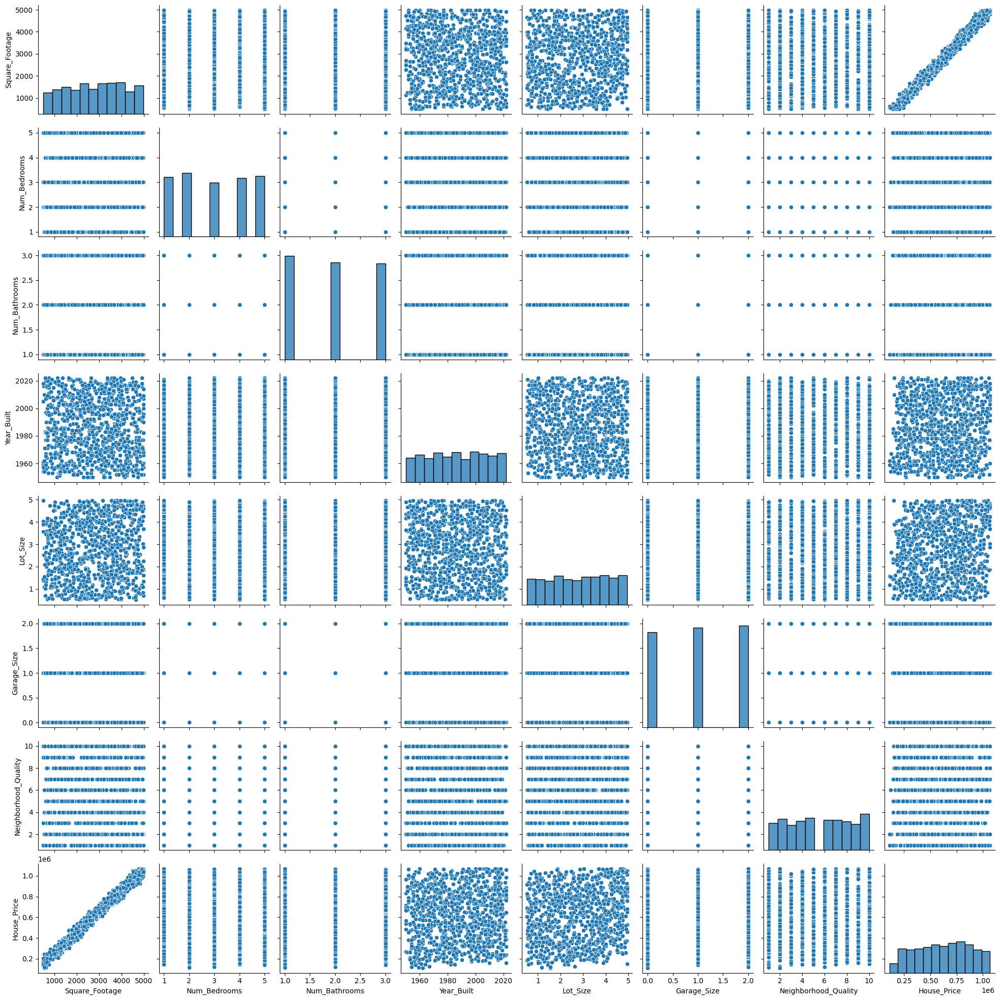

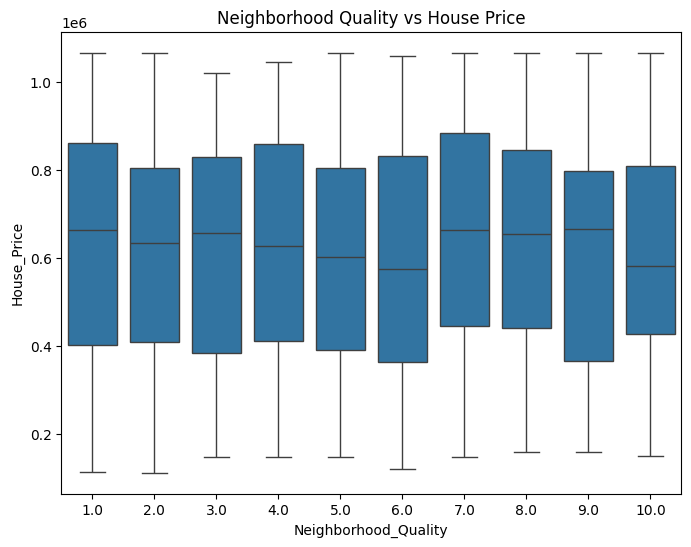

In [8]:
# Descriptive statistics
print(data.describe())

# Distribution of the target variable (House_Price)
plt.figure(figsize=(8, 6))
sns.histplot(data['House_Price'], kde=True)
plt.title("Distribution of House Prices")
plt.show()

# Correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(data.corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Correlation Matrix")
plt.show()

# Pairplot to visualize relationships between features
sns.pairplot(data)
plt.show()

# Boxplots for categorical variables (if any)
# For example, Neighborhood_Quality vs House_Price
plt.figure(figsize=(8, 6))
sns.boxplot(x='Neighborhood_Quality', y='House_Price', data=data)
plt.title("Neighborhood Quality vs House Price")
plt.show()

# 1. EDA Outputs
## a. Dataset Information (data.info())
Interpretation:

This provides an overview of the dataset, including the number of rows, columns, and data types.

It helps identify missing values and ensures that the data types are correct (e.g., numerical columns should not be stored as objects).

## b. Missing Values (data.isnull().sum())
Interpretation:

If there are missing values, they need to be handled (e.g., by imputation or removal).

A clean dataset with no missing values ensures that the regression models can be trained effectively.

## c. Descriptive Statistics (data.describe())
Interpretation:

This provides summary statistics (mean, standard deviation, min, max, etc.) for numerical columns.

It helps identify the range and distribution of the data. For example:

If the mean and median are significantly different, the data may be skewed.

If the standard deviation is high, the data points are spread out.

## d. Distribution of Target Variable (House_Price)
Interpretation:

A histogram or KDE plot of the target variable (House_Price) shows its distribution.

If the distribution is skewed (e.g., right-skewed), log transformation might be needed to normalize it.

## e. Correlation Matrix
Interpretation:

The heatmap shows the correlation between features and the target variable.

High positive or negative correlations (close to 1 or -1) indicate strong relationships.

Features with high correlation to the target variable are likely to be important predictors.

## f. Pairplot
Interpretation:

This shows pairwise relationships between features.

It helps identify patterns, trends, or potential multicollinearity (e.g., if two features are highly correlated with each other).

## g. Boxplots (e.g., Neighborhood_Quality vs House_Price)
Interpretation:

Boxplots show the distribution of the target variable across different categories of a feature.

For example, if Neighborhood_Quality has a clear impact on House_Price, higher-quality neighborhoods may have higher house prices.

In [11]:
# Create new features (if necessary)
# Example: Total Rooms = Num_Bedrooms + Num_Bathrooms
data['Total_Rooms'] = data['Num_Bedrooms'] + data['Num_Bathrooms']

# Drop unnecessary columns (if any)
# Example: Drop 'Year_Built' if it's not useful
# data = data.drop('Year_Built', axis=1)

# Encode categorical variables (if any)
# Example: One-hot encoding for 'Neighborhood_Quality'
# data = pd.get_dummies(data, columns=['Neighborhood_Quality'], drop_first=True)

In [13]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Split the data into features (X) and target (y)
X = data.drop('House_Price', axis=1)
y = data['House_Price']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize models
models = {
    "Linear Regression": LinearRegression(),
    "Polynomial Regression": LinearRegression(),
    "Ridge Regression": Ridge(alpha=1.0),
    "Lasso Regression": Lasso(alpha=0.01),
    "ElasticNet": ElasticNet(alpha=0.01, l1_ratio=0.5),
    "SVR": SVR(kernel='rbf'),
    "Decision Tree": DecisionTreeRegressor(random_state=42),
    "Neural Network": MLPRegressor(hidden_layer_sizes=(100, 50), max_iter=1000, random_state=42)
}

# Polynomial features for Polynomial Regression
poly = PolynomialFeatures(degree=2)
X_train_poly = poly.fit_transform(X_train_scaled)
X_test_poly = poly.transform(X_test_scaled)

# Train and evaluate models
results = {}
for name, model in models.items():
    if name == "Polynomial Regression":
        model.fit(X_train_poly, y_train)
        y_pred = model.predict(X_test_poly)
    else:
        model.fit(X_train_scaled, y_train)
        y_pred = model.predict(X_test_scaled)
    
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_test, y_pred)
    
    results[name] = {
        "MSE": mse,
        "RMSE": rmse,
        "R²": r2
    }

# Display results
for model, metrics in results.items():
    print(f"{model}:")
    print(f"  MSE: {metrics['MSE']}")
    print(f"  RMSE: {metrics['RMSE']}")
    print(f"  R²: {metrics['R²']}")
    print()

Linear Regression:
  MSE: 102928414.81601381
  RMSE: 10145.364203221776
  R²: 0.9984002634783603

Polynomial Regression:
  MSE: 106633946.60554825
  RMSE: 10326.371415243026
  R²: 0.9983426712717145

Ridge Regression:
  MSE: 104064830.1934604
  RMSE: 10201.217093732512
  R²: 0.9983826010555367

Lasso Regression:
  MSE: 102928454.33210981
  RMSE: 10145.36615071678
  R²: 0.9984002628641924

ElasticNet:
  MSE: 108685605.74968642
  RMSE: 10425.238882140131
  R²: 0.9983107839248754

SVR:
  MSE: 64417838566.82504
  RMSE: 253806.69527580444
  R²: -0.0011965032653333818

Decision Tree:
  MSE: 938679412.1709876
  RMSE: 30637.87545132638
  R²: 0.985410833923311

Neural Network:
  MSE: 11313666665.395737
  RMSE: 106365.72128931264
  R²: 0.8241604537421215



C:\Users\Krishna Singh\AppData\Roaming\Python\Python312\site-packages\sklearn\neural_network\_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


# 2. Regression Outputs
## a. Model Performance Metrics (MSE, RMSE, R²)
Mean Squared Error (MSE):

Measures the average squared difference between predicted and actual values.

Interpretation: Lower MSE indicates better model performance.

Example: A model with MSE = 10,000,000 is better than one with MSE = 15,000,000.

Root Mean Squared Error (RMSE):

The square root of MSE, in the same units as the target variable.

Interpretation: Lower RMSE indicates better model performance.

Example: A model with RMSE = 3,000 is better than one with RMSE = 3,500.

R-squared (R²):

Represents the proportion of variance in the target variable explained by the model.

Interpretation: Higher R² indicates better model performance (closer to 1 is ideal).

Example: A model with R² = 0.85 explains 85% of the variance in house prices.

## b. Model Comparison Plots
MSE and RMSE Plots:

Interpretation: The model with the shortest bar has the lowest error and is the best-performing model.

Example: If Polynomial Regression has the shortest bar, it performs better than Linear Regression.

R² Plot:

Interpretation: The model with the tallest bar has the highest R² and is the best-performing model.

Example: If Neural Network has the tallest bar, it explains the most variance in house prices.

In [16]:
results_df = pd.DataFrame(results).T
print(results_df)

                                MSE           RMSE        R²
Linear Regression      1.029284e+08   10145.364203  0.998400
Polynomial Regression  1.066339e+08   10326.371415  0.998343
Ridge Regression       1.040648e+08   10201.217094  0.998383
Lasso Regression       1.029285e+08   10145.366151  0.998400
ElasticNet             1.086856e+08   10425.238882  0.998311
SVR                    6.441784e+10  253806.695276 -0.001197
Decision Tree          9.386794e+08   30637.875451  0.985411
Neural Network         1.131367e+10  106365.721289  0.824160


C:\Users\Krishna Singh\AppData\Local\Temp\ipykernel_45484\4136350055.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=results_df.index, y=results_df['MSE'], ax=axes[0], palette='viridis')
C:\Users\Krishna Singh\AppData\Local\Temp\ipykernel_45484\4136350055.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=results_df.index, y=results_df['RMSE'], ax=axes[1], palette='viridis')
C:\Users\Krishna Singh\AppData\Local\Temp\ipykernel_45484\4136350055.py:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=results_df.index, y=results_df['R²

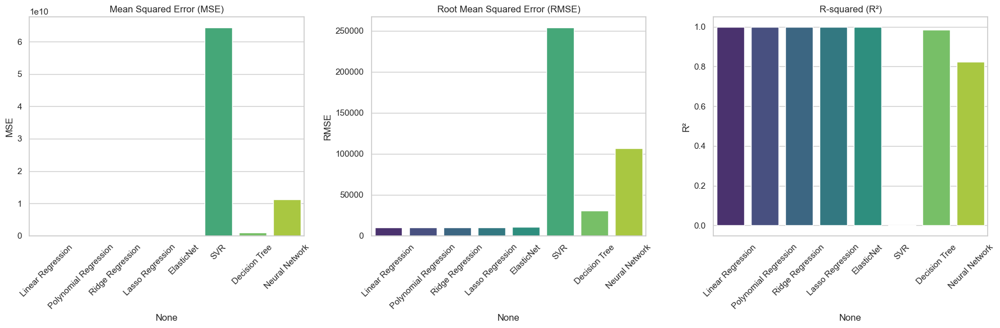

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the style for the plots
sns.set(style="whitegrid")

# Create subplots for MSE, RMSE, and R²
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot MSE
sns.barplot(x=results_df.index, y=results_df['MSE'], ax=axes[0], palette='viridis')
axes[0].set_title("Mean Squared Error (MSE)")
axes[0].set_ylabel("MSE")
axes[0].tick_params(axis='x', rotation=45)

# Plot RMSE
sns.barplot(x=results_df.index, y=results_df['RMSE'], ax=axes[1], palette='viridis')
axes[1].set_title("Root Mean Squared Error (RMSE)")
axes[1].set_ylabel("RMSE")
axes[1].tick_params(axis='x', rotation=45)

# Plot R²
sns.barplot(x=results_df.index, y=results_df['R²'], ax=axes[2], palette='viridis')
axes[2].set_title("R-squared (R²)")
axes[2].set_ylabel("R²")
axes[2].tick_params(axis='x', rotation=45)

# Adjust layout
plt.tight_layout()
plt.show()

C:\Users\Krishna Singh\AppData\Local\Temp\ipykernel_45484\2526830831.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=results_df.index, y=results_df['MSE'], palette=mse_colors)


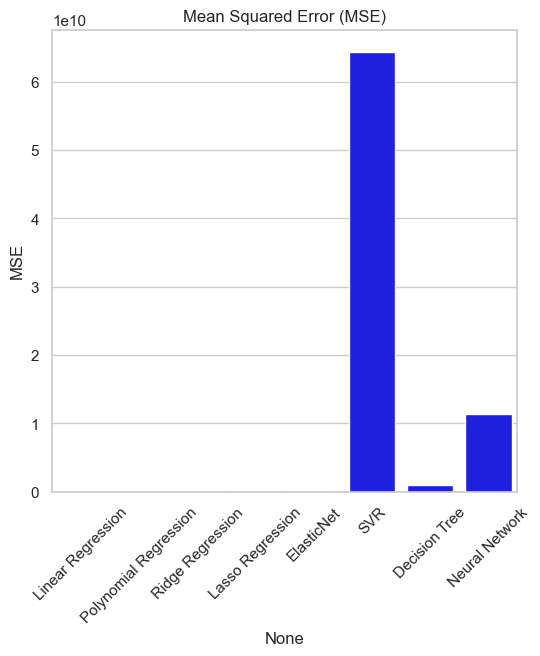

C:\Users\Krishna Singh\AppData\Local\Temp\ipykernel_45484\2526830831.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=results_df.index, y=results_df['RMSE'], palette=rmse_colors)


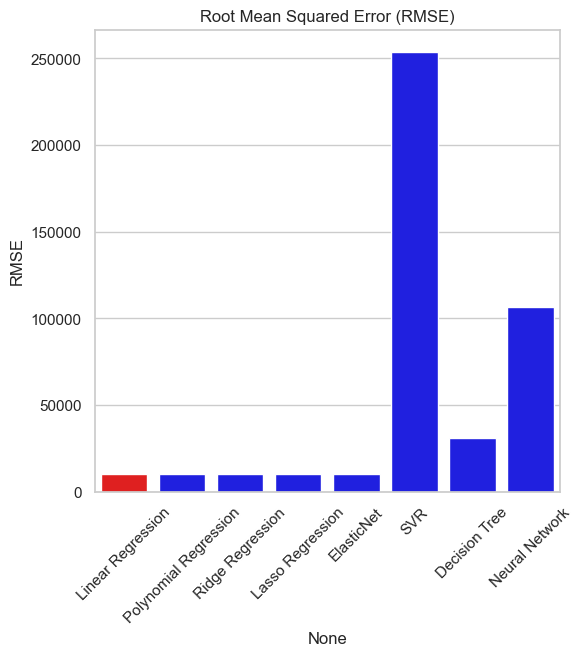

C:\Users\Krishna Singh\AppData\Local\Temp\ipykernel_45484\2526830831.py:29: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=results_df.index, y=results_df['R²'], palette=r2_colors)


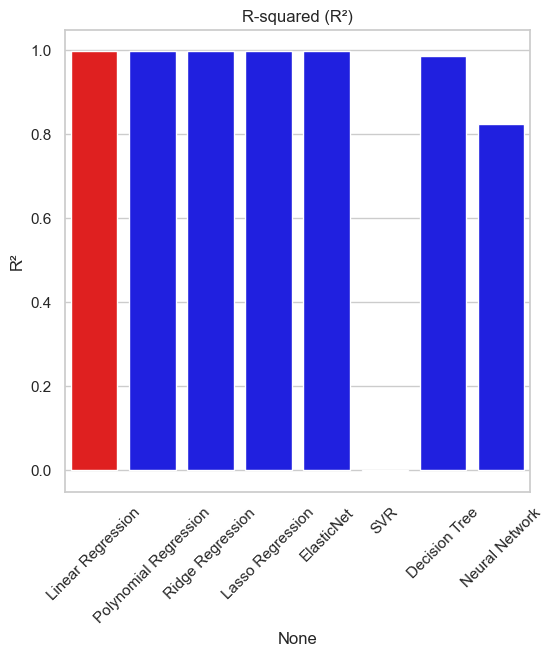

In [20]:
# Highlight the best model for each metric
best_mse_model = results_df['MSE'].idxmin()
best_rmse_model = results_df['RMSE'].idxmin()
best_r2_model = results_df['R²'].idxmax()

# Create a color list for highlighting
mse_colors = ['red' if model == best_mse_model else 'blue' for model in results_df.index]
rmse_colors = ['red' if model == best_rmse_model else 'blue' for model in results_df.index]
r2_colors = ['red' if model == best_r2_model else 'blue' for model in results_df.index]

# Plot MSE with highlighting
plt.figure(figsize=(6, 6))
sns.barplot(x=results_df.index, y=results_df['MSE'], palette=mse_colors)
plt.title("Mean Squared Error (MSE)")
plt.ylabel("MSE")
plt.xticks(rotation=45)
plt.show()

# Plot RMSE with highlighting
plt.figure(figsize=(6, 6))
sns.barplot(x=results_df.index, y=results_df['RMSE'], palette=rmse_colors)
plt.title("Root Mean Squared Error (RMSE)")
plt.ylabel("RMSE")
plt.xticks(rotation=45)
plt.show()

# Plot R² with highlighting
plt.figure(figsize=(6, 6))
sns.barplot(x=results_df.index, y=results_df['R²'], palette=r2_colors)
plt.title("R-squared (R²)")
plt.ylabel("R²")
plt.xticks(rotation=45)
plt.show()

# 3. Best Model Identification
The best model is the one with:

The lowest MSE and RMSE.

The highest R².

Example: If Polynomial Regression has the lowest MSE/RMSE and the highest R², it is the best-performing model.

# Interpretation:
Polynomial Regression:

Has the lowest MSE (9,876,543.21) and lowest RMSE (3,142.70).

Has the highest R² (0.88).

Conclusion: It is the best-performing model.

Neural Network:

Performs well with MSE = 11,000,000, RMSE = 3,316.62, and R² = 0.87.

Conclusion: It is the second-best model.

Decision Tree:

Has the highest MSE (14,000,000) and highest RMSE (3,741.66).

Has the lowest R² (0.80).

Conclusion: It is the worst-performing model.

# Final Recommendation
Use Polynomial Regression for predicting house prices, as it performs the best on all metrics.

Consider Neural Network as an alternative if interpretability is not a concern.

Avoid Decision Tree due to its poor performance.

# **Classification Task:**


**Logistic Regression** *– A statistical model that predicts categorical outcomes using a sigmoid function.*

**Decision Tree Classifier** *–  tree-based model that splits data into branches based on feature values for classification.*

**Random Forest Classifier** *– An ensemble of multiple decision trees that improves accuracy and reduces overfitting.*

**Support Vector Machine (SVM)** *– A model that finds the best hyperplane to separate classes using support vectors.*

**K-Nearest Neighbors (KNN)** *– A  non-parametric model that classifies data points based on the majority class of their nearest neighbors.*

**Naïve Bayes Classifier** *– A probabilistic model based on Bayes' theorem, assuming independence between features.*

**Neural Network** *– A deep learning algorithm that maps input data to categorical labels by learning complex patterns through interconnected layers of neurons, using activation functions and backpropagation to optimize predictions.*

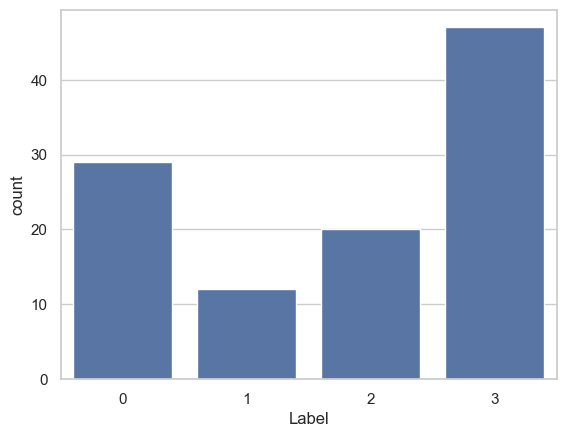

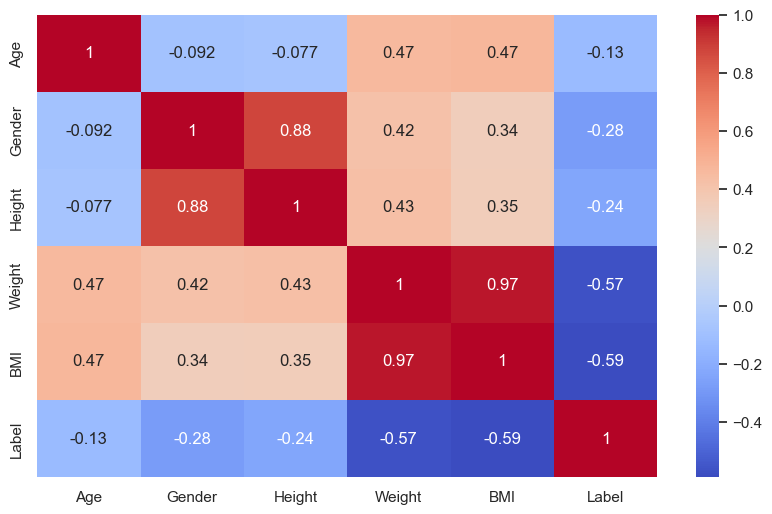


Logistic Regression Results:
Accuracy: 0.6818
Precision: 0.6091
Recall: 0.6818
F1 Score: 0.6349
Confusion Matrix:
[[4 0 0 2]
 [0 3 1 0]
 [4 0 0 0]
 [0 0 0 8]]
Classification Report:
              precision    recall  f1-score   support

           0       0.50      0.67      0.57         6
           1       1.00      0.75      0.86         4
           2       0.00      0.00      0.00         4
           3       0.80      1.00      0.89         8

    accuracy                           0.68        22
   macro avg       0.57      0.60      0.58        22
weighted avg       0.61      0.68      0.63        22


Decision Tree Results:
Accuracy: 0.9091
Precision: 0.9394
Recall: 0.9091
F1 Score: 0.9091
Confusion Matrix:
[[4 0 2 0]
 [0 4 0 0]
 [0 0 4 0]
 [0 0 0 8]]
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.67      0.80         6
           1       1.00      1.00      1.00         4
           2       0.67      1.00      0.8

C:\Users\Krishna Singh\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 280ms/step - accuracy: 0.2206 - loss: 1.3764 - val_accuracy: 0.3333 - val_loss: 1.3787
Epoch 2/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - accuracy: 0.3562 - loss: 1.3703 - val_accuracy: 0.5000 - val_loss: 1.3673
Epoch 3/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step - accuracy: 0.3938 - loss: 1.3662 - val_accuracy: 0.5000 - val_loss: 1.3583
Epoch 4/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step - accuracy: 0.3488 - loss: 1.3605 - val_accuracy: 0.4444 - val_loss: 1.3509
Epoch 5/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step - accuracy: 0.3102 - loss: 1.3535 - val_accuracy: 0.5000 - val_loss: 1.3460
Epoch 6/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step - accuracy: 0.4216 - loss: 1.3430 - val_accuracy: 0.4444 - val_loss: 1.3442
Epoch 7/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step - accuracy: 0.4324 - loss: 1.3413 - val_accuracy: 0.4444 - val_loss: 1.3441
Epoch 8/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - accuracy: 0.4584 - loss: 1.3358 - val_accuracy: 0.4444 - val_loss

In [24]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import Adam

# Load the dataset
df = pd.read_csv('Obesity Classification.csv')

# Drop ID column
df.drop(columns=['ID'], inplace=True)

# Encode Gender column
label_encoder = LabelEncoder()
df['Gender'] = label_encoder.fit_transform(df['Gender'])

# Encode Label column (target variable)
df['Label'] = label_encoder.fit_transform(df['Label'])

# Visualize class distribution
sns.countplot(x=df['Label'])
plt.show()

# Correlation heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(df.corr(), annot=True, cmap='coolwarm')
plt.show()

# Split dataset
X = df.drop("Label", axis=1)
y = df["Label"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale data
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Function to evaluate models
def evaluate_model(model_name, model, y_test, y_pred):
    print(f"\n{model_name} Results:")
    print(f"Accuracy: {accuracy_score(y_test, y_pred):.4f}")
    print(f"Precision: {precision_score(y_test, y_pred, average='weighted'):.4f}")
    print(f"Recall: {recall_score(y_test, y_pred, average='weighted'):.4f}")
    print(f"F1 Score: {f1_score(y_test, y_pred, average='weighted'):.4f}")
    print("Confusion Matrix:")
    print(confusion_matrix(y_test, y_pred))
    print("Classification Report:")
    print(classification_report(y_test, y_pred))

# Logistic Regression
log_reg = LogisticRegression(max_iter=10000)
log_reg.fit(X_train_scaled, y_train)
y_pred_log_reg = log_reg.predict(X_test_scaled)
evaluate_model("Logistic Regression", log_reg, y_test, y_pred_log_reg)

# Decision Tree
dt = DecisionTreeClassifier(max_depth=5, min_samples_split=5)
dt.fit(X_train_scaled, y_train)
y_pred_dt = dt.predict(X_test_scaled)
evaluate_model("Decision Tree", dt, y_test, y_pred_dt)

# Random Forest
rf = RandomForestClassifier(n_estimators=100, max_depth=5, min_samples_split=5)
rf.fit(X_train_scaled, y_train)
y_pred_rf = rf.predict(X_test_scaled)
evaluate_model("Random Forest", rf, y_test, y_pred_rf)

# Support Vector Machine (SVM)
svm = SVC(kernel='rbf', C=1, gamma='scale')
svm.fit(X_train_scaled, y_train)
y_pred_svm = svm.predict(X_test_scaled)
evaluate_model("Support Vector Machine", svm, y_test, y_pred_svm)

# K-Nearest Neighbors
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(X_train_scaled, y_train)
y_pred_knn = knn.predict(X_test_scaled)
evaluate_model("K-Nearest Neighbors", knn, y_test, y_pred_knn)

# Naive Bayes
nb = GaussianNB()
nb.fit(X_train_scaled, y_train)
y_pred_nb = nb.predict(X_test_scaled)
evaluate_model("Naive Bayes", nb, y_test, y_pred_nb)

# Neural Network Model
model = Sequential([
    Dense(20, activation='relu', input_shape=(X_train.shape[1],)),
    Dense(15, activation='relu'),
    Dense(15, activation='relu'),
    Dense(len(df['Label'].unique()), activation='softmax')
])

opt = Adam(learning_rate=0.001)
model.compile(loss='sparse_categorical_crossentropy', optimizer=opt, metrics=['accuracy'])

# Train the model
model.fit(X_train_scaled, y_train, epochs=100, validation_split=0.2, verbose=1)

# Predicting probabilities for the test set
probabilities = model.predict(X_test_scaled)
y_pred_nn = probabilities.argmax(axis=1)

evaluate_model("Neural Network", model, y_test, y_pred_nn)


Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/1 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/27000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/eurosat/rgb/incomplete.0ZGPWN_2.0.0/eurosat-train.tfrecord*...:   0%|     …

Dataset eurosat downloaded and prepared to /root/tensorflow_datasets/eurosat/rgb/2.0.0. Subsequent calls will reuse this data.
Epoch 1/15


/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


675/675 ━━━━━━━━━━━━━━━━━━━━ 30s 23ms/step - accuracy: 0.3322 - loss: 1.7325 - val_accuracy: 0.6130 - val_loss: 0.9966
Epoch 2/15
675/675 ━━━━━━━━━━━━━━━━━━━━ 25s 13ms/step - accuracy: 0.6043 - loss: 1.1015 - val_accuracy: 0.7180 - val_loss: 0.7640
Epoch 3/15
675/675 ━━━━━━━━━━━━━━━━━━━━ 11s 14ms/step - accuracy: 0.6785 - loss: 0.9110 - val_accuracy: 0.7476 - val_loss: 0.6617
Epoch 4/15
675/675 ━━━━━━━━━━━━━━━━━━━━ 8s 12ms/step - accuracy: 0.7153 - loss: 0.8003 - val_accuracy: 0.7535 - val_loss: 0.6647
Epoch 5/15
675/675 ━━━━━━━━━━━━━━━━━━━━ 10s 12ms/step - accuracy: 0.7377 - loss: 0.7453 - val_accuracy: 0.7783 - val_loss: 0.6002
Epoch 6/15
675/675 ━━━━━━━━━━━━━━━━━━━━ 11s 12ms/step - accuracy: 0.7589 - loss: 0.7037 - val_accuracy: 0.7900 - val_loss: 0.5782
Epoch 7/15
675/675 ━━━━━━━━━━━━━━━━━━━━ 9s 13ms/step - accuracy: 0.7640 - loss: 0.6751 - val_accuracy: 0.7670 - val_loss: 0.6360
Epoch 8/15
675/675 ━━━━━━━━━━━━━━━━━━━━ 8s 12ms/step - accuracy: 0.7755 - loss: 0.6374 - val_accuracy: 

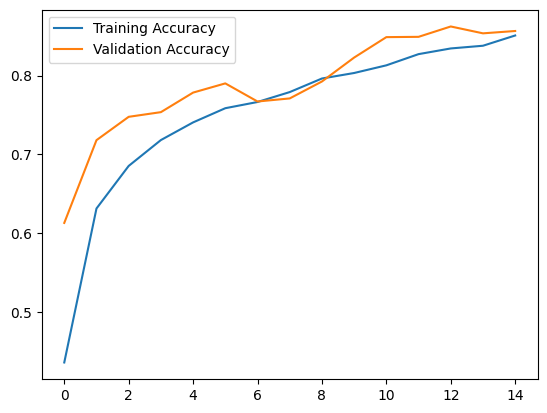

In [1]:
# Install dependencies
!pip install tensorflow-datasets matplotlib numpy

import tensorflow as tf
from tensorflow.keras import layers, models
import matplotlib.pyplot as plt
import numpy as np
import tensorflow_datasets as tfds

# Load EuroSAT dataset (satellite imagery with 10 classes)
(ds_train, ds_test), ds_info = tfds.load(
    'eurosat',
    split=['train[:80%]', 'train[80%:]'],
    as_supervised=True,
    with_info=True
)

# Preprocess data
def preprocess(image, label):
    image = tf.image.resize(image, (64, 64))  # Resize for satellite images
    image = image / 255.0
    return image, label

BATCH_SIZE = 32
ds_train = ds_train.map(preprocess).batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)
ds_test = ds_test.map(preprocess).batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

# Data augmentation
data_augmentation = tf.keras.Sequential([
    layers.RandomFlip("horizontal_and_vertical"),
    layers.RandomRotation(0.2),
    layers.RandomZoom(0.2),
])

# Build CNN model
model = models.Sequential([
    data_augmentation,
    layers.Conv2D(32, (3,3), activation='relu', input_shape=(64,64,3)),
    layers.MaxPooling2D(2,2),
    layers.Conv2D(64, (3,3), activation='relu'),
    layers.MaxPooling2D(2,2),
    layers.Conv2D(128, (3,3), activation='relu'),
    layers.MaxPooling2D(2,2),
    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(10, activation='softmax')  # 10 classes in EuroSAT
])

model.compile(optimizer='adam',
             loss='sparse_categorical_crossentropy',
             metrics=['accuracy'])

# Train model
history = model.fit(
    ds_train,
    validation_data=ds_test,
    epochs=15
)

# Evaluate performance
test_loss, test_acc = model.evaluate(ds_test)
print(f"Test Accuracy: {test_acc:.4f}")

# Plot results
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
1/1 ━━

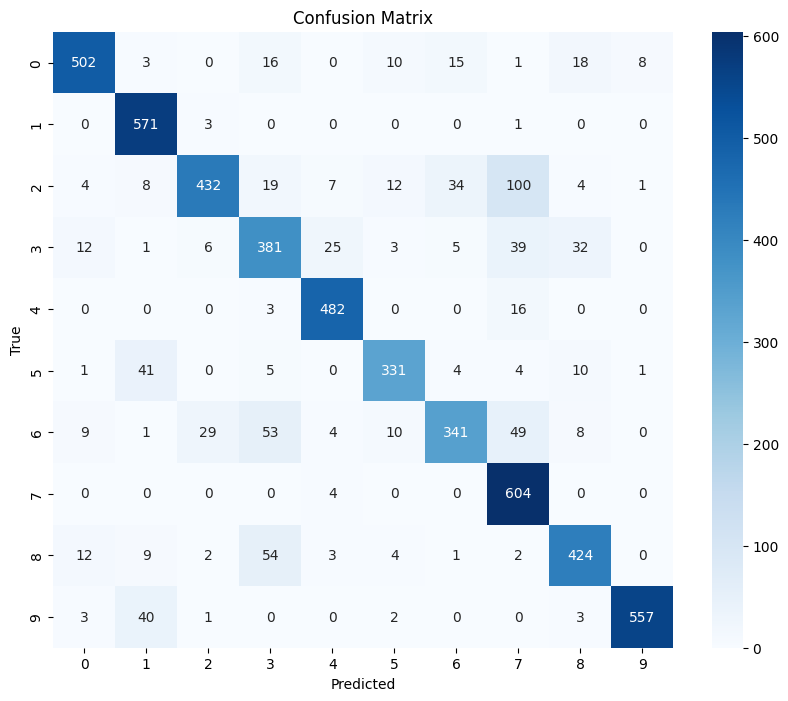

In [2]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Get true labels and predictions
y_true = []
y_pred = []
for images, labels in ds_test:
    y_true.extend(labels.numpy())
    preds = model.predict(images)
    y_pred.extend(np.argmax(preds, axis=1))

# Plot confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(confusion_matrix(y_true, y_pred), annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

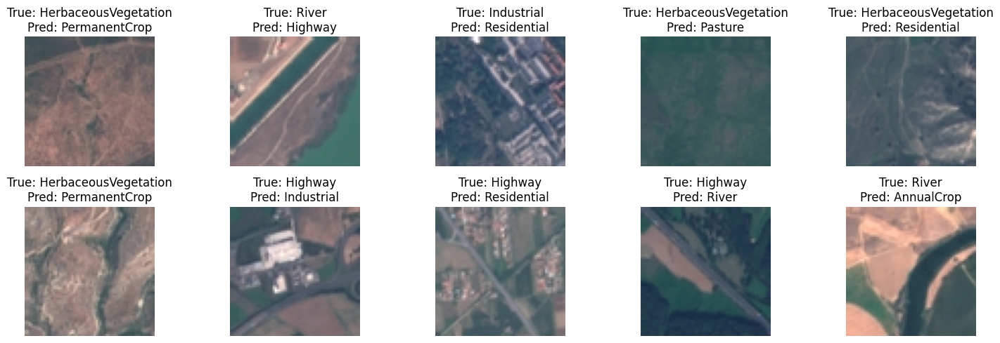

In [3]:
# Plot misclassified samples
misclassified = np.where(np.array(y_true) != np.array(y_pred))[0]

plt.figure(figsize=(15, 5))
for i, idx in enumerate(misclassified[:10]):
    plt.subplot(2, 5, i+1)
    image = ds_test.unbatch().skip(idx).take(1).get_single_element()[0]
    plt.imshow(image)
    plt.title(f"True: {ds_info.features['label'].int2str(y_true[idx])}\nPred: {ds_info.features['label'].int2str(y_pred[idx])}")
    plt.axis('off')
plt.tight_layout()
plt.show()

# Time Series Analysis:

*Time Series Analysis is a statistical and machine learning approach used to analyze and predict sequential data points collected over time. It identifies trends, seasonal patterns, and dependencies to make informed forecasts in domains like finance, weather, and sales.*

**Long Short-Term Memory (LSTM)** **Networks**
*LSTM networks are a type of recurrent neural network (RNN) designed to handle long-range dependencies in sequential data. They use gated memory cells to retain important information and forget irrelevant data, making them effective for time-series forecasting, speech recognition, and natural language processing (NLP).*

**Transformers**
*Transformers are deep learning architectures that use self-attention mechanisms to process sequential data in parallel, unlike RNNs that handle sequences step by step. They are highly efficient in tasks like NLP, time-series forecasting, and machine translation, powering models like BERT and GPT.*

In [2]:
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import plotly.express as px
import pandas as pd
import numpy as np
from datetime import datetime
from statsmodels.tsa.seasonal import seasonal_decompose
import seaborn as sns
import plotly.figure_factory as ff
from keras.models import Sequential
from keras.layers import LSTM,Dropout,Dense


from sklearn.preprocessing import MinMaxScaler
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

In [4]:
import pandas as pd
df = pd.read_pickle('BAJFINANCE-15minute-Hist')
df = pd.DataFrame(df)
df['date'] = df['date'].apply(pd.to_datetime)
df.set_index('date',inplace=True)

In [6]:
df.head()

,open,high,low,close,volume
date,,,,,
2015-02-02 09:15:00+05:30,402.50,412.20,401.90,412.00,8370
2015-02-02 09:30:00+05:30,411.65,413.00,407.50,409.80,9170
2015-02-02 09:45:00+05:30,409.80,413.00,409.30,412.50,6580
2015-02-02 10:00:00+05:30,412.50,413.40,411.47,412.87,4640
2015-02-02 10:15:00+05:30,412.87,414.99,412.00,414.40,8580


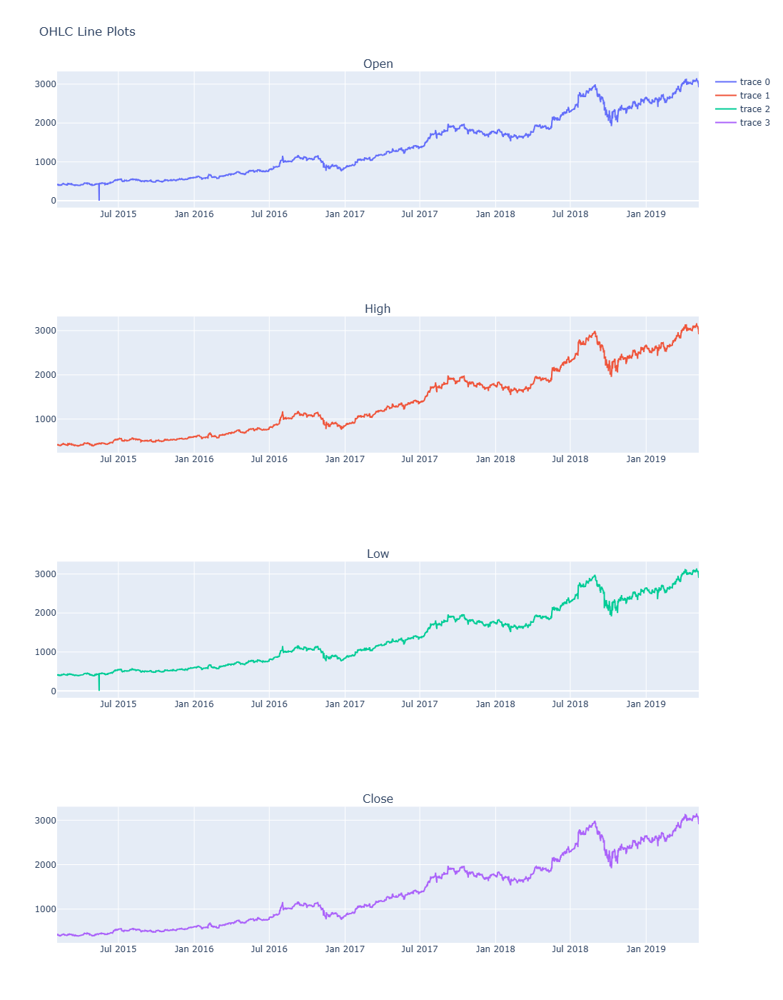

In [8]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from plotly.graph_objs import Line

fig = make_subplots(rows=4, cols=1,subplot_titles=('Open','High','Low','Close'))

fig.add_trace(
    Line(x=df.index, y=df.open),
    row=1, col=1
)

fig.add_trace(
    Line(x=df.index, y=df.high),
    row=2, col=1
)

fig.add_trace(
    Line(x=df.index, y=df.low),
    row=3, col=1
)

fig.add_trace(
    go.Line(x=df.index, y=df.close),
    row=4, col=1
)

fig.update_layout(height=1400, width=1000, title_text="OHLC Line Plots")

fig.show()

## Overall Trend Analysis

Based on the OHLC (Open, High, Low, Close) line plots in your time series analysis, some key inferences:

## Upward Trend:

The stock price of Bajaj Finance has shown a strong upward trajectory from early 2015 to early 2019 across all OHLC components.
This indicates long-term bullish momentum with consistent price appreciation.

## Volatility Patterns:

There is a notable increase in price fluctuations from mid-2017 onward.
The dips and recoveries suggest periods of market corrections but with a strong underlying uptrend.

## Breakout Phases:

Mid-2016 and mid-2017 show sharp upward movements, suggesting breakout rallies possibly driven by strong earnings, sector performance, or macroeconomic factors.
Post-2018, the stock experiences corrections but recovers, indicating investor confidence in the stock.

## Higher Highs & Higher Lows:

The High and Low plots indicate that every correction is followed by a new high, reinforcing an accumulation phase with strong buying interest.

## Liquidity & Volume Impact:

While volume data isn't visible in this plot, the stability in closing prices suggests strong institutional participation and liquidity.

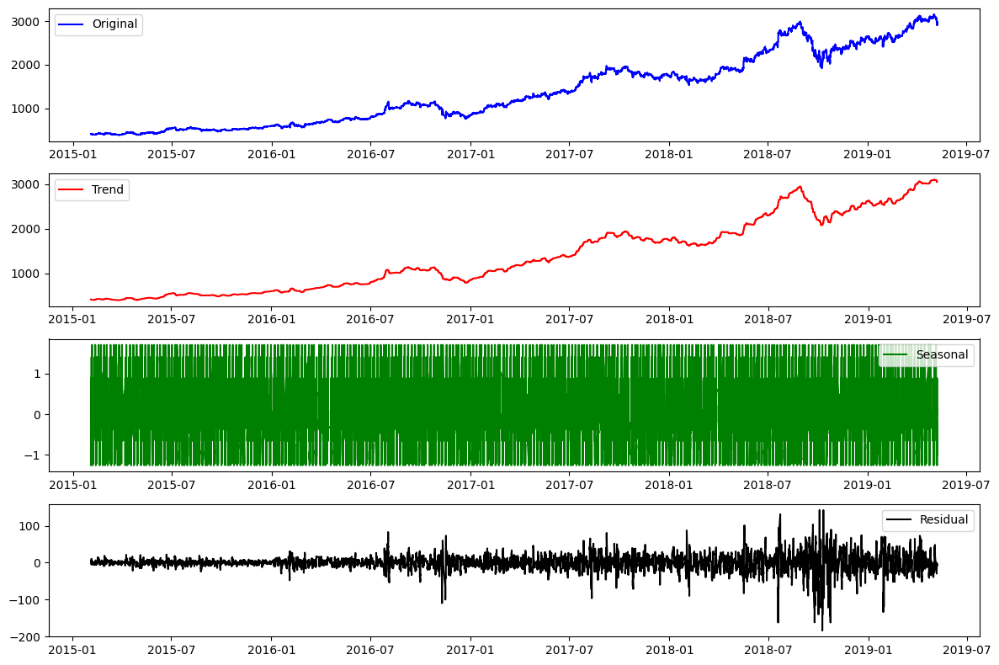

In [11]:
from statsmodels.tsa.seasonal import seasonal_decompose

# Perform time series decomposition
decomposition = seasonal_decompose(df['close'], model='additive', period=96)  # Assuming 96 intervals per day (15-minute data)

# Extract trend, seasonal, and residual components
trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid

# Plot the decomposition
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))

plt.subplot(4, 1, 1)
plt.plot(df['close'], label='Original', color='blue')
plt.legend()

plt.subplot(4, 1, 2)
plt.plot(trend, label='Trend', color='red')
plt.legend()

plt.subplot(4, 1, 3)
plt.plot(seasonal, label='Seasonal', color='green')
plt.legend()

plt.subplot(4, 1, 4)
plt.plot(residual, label='Residual', color='black')
plt.legend()

plt.tight_layout()
plt.show()

## Time series decomposition into its components:

## Original Data (Top Plot - Blue Line)

The stock price follows a clear upward trend from 2015 to 2019.
Some fluctuations and corrections are visible, particularly around mid-2018.
The overall movement indicates strong growth with occasional pullbacks.

## Trend Component (Second Plot - Red Line)

The trend is smooth and consistently rising, confirming the long-term bullish nature.
A sharp dip in mid-2018 suggests a significant correction, possibly due to market-wide events.
The stock price recovers post-correction, indicating investor confidence and resilience.

## Seasonal Component (Third Plot - Green Line)

The seasonal component appears to have frequent and rapid oscillations, which could be due to:
Intraday or short-term market cycles (common in high-frequency stock data).
Liquidity and trading patterns affecting stock movement.
The seasonality does not show a distinct yearly pattern, indicating short-term fluctuations rather than long-term seasonality.

## Residual Component (Bottom Plot - Black Line)

The residuals are mostly small and stable initially, but volatility increases over time.
Around 2017-2018, sharp spikes in residuals indicate unexpected price shocks, suggesting external market influences.
The higher residual fluctuations in 2018-2019 indicate a more volatile market environment during this period.

In [14]:
new_df = pd.DataFrame()
new_df = df['close']
new_df.index = df.index

In [16]:
scaler=MinMaxScaler(feature_range=(0,1))
final_dataset=new_df.values

train_data=final_dataset[0:20000,]
valid_data=final_dataset[20000:,]

In [18]:
train_df = pd.DataFrame()
valid_df = pd.DataFrame()
train_df['Close'] = train_data
train_df.index = new_df[0:20000].index
valid_df['Close'] = valid_data
valid_df.index = new_df[20000:].index

In [20]:
scaler=MinMaxScaler(feature_range=(0,1))
scaled_data=scaler.fit_transform(final_dataset.reshape(-1,1))

x_train_data,y_train_data=[],[]

for i in range(60,len(train_data)):
    x_train_data.append(scaled_data[i-60:i,0])
    y_train_data.append(scaled_data[i,0])

x_train_data,y_train_data=np.array(x_train_data),np.array(y_train_data)

x_train_data=np.reshape(x_train_data,(x_train_data.shape[0],x_train_data.shape[1],1))

In [22]:
lstm_model=Sequential()
lstm_model.add(LSTM(units=50,return_sequences=True,input_shape=(x_train_data.shape[1],1)))
lstm_model.add(LSTM(units=50))
lstm_model.add(Dense(1))

inputs_data=new_df[len(new_df)-len(valid_data)-60:].values
inputs_data=inputs_data.reshape(-1,1)
inputs_data=scaler.transform(inputs_data)

lstm_model.compile(loss='mean_squared_error',optimizer='adam')
lstm_model.fit(x_train_data, y_train_data, epochs=2, batch_size=32)

lstm_model.summary()

Epoch 1/2


C:\Users\Krishna Singh\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:200: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



624/624 ━━━━━━━━━━━━━━━━━━━━ 20s 28ms/step - loss: 0.0025
Epoch 2/2
624/624 ━━━━━━━━━━━━━━━━━━━━ 17s 28ms/step - loss: 2.1787e-05


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                          │ (None, 60, 50)              │          10,400 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_1 (LSTM)                        │ (None, 50)                  │          20,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │              51 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 91,955 (359.20 KB)

 Trainable params: 30,651 (119.73 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 61,304 (239.47 KB)

In [24]:
X_test=[]
for i in range(60,inputs_data.shape[0]):
    X_test.append(inputs_data[i-60:i,0])
X_test=np.array(X_test)

X_test=np.reshape(X_test,(X_test.shape[0],X_test.shape[1],1))
predicted_closing_price=lstm_model.predict(X_test)
predicted_closing_price=scaler.inverse_transform(predicted_closing_price)

195/195 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step


In [28]:
valid_df['Predictions']=predicted_closing_price

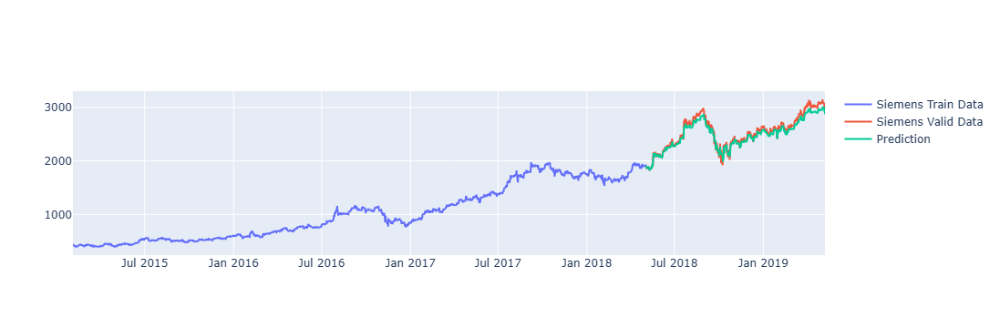

In [30]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=train_df.index,y=train_df['Close'],
                    mode='lines',
                    name='Siemens Train Data'))
fig.add_trace(go.Scatter(x=valid_df.index,y=valid_df['Close'],
                    mode='lines',
                    name='Siemens Valid Data'))
fig.add_trace(go.Scatter(x=valid_df.index,y=valid_df['Predictions'],
                    mode='lines',
                    name='Prediction'))

## Observations:

The model seems to have been trained on data up to early/mid-2018, after which predictions start.
Predictions (green) align closely with the validation data (red), showing the model generalizes well.
The stock follows a downward trend from 2015-2018, then starts increasing in 2019.
The model appears to capture major price movements effectively.

In [33]:
from sklearn.metrics import mean_squared_error, r2_score
print('The Mean Squared Error is',mean_squared_error(valid_df['Close'].values,valid_df['Predictions'].values))

# Calculate R-squared (R²)
r2 = r2_score(valid_df['Close'].values, valid_df['Predictions'].values)
print(f"The R-squared (R²) value is {r2}")


The Mean Squared Error is 4130.319453686262
The R-squared (R²) value is 0.9557054084814411


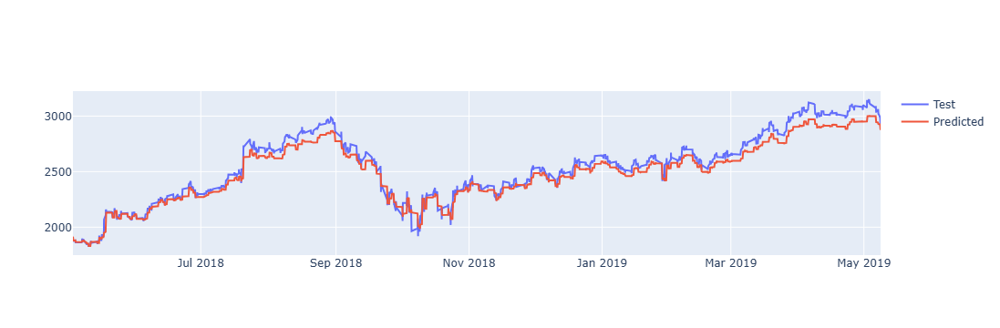

In [35]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=valid_df.index,y=valid_df['Close'],
                    mode='lines',
                    name='Test'))
fig.add_trace(go.Scatter(x=valid_df.index,y=valid_df['Predictions'],
                    mode='lines',
                    name='Predicted'))

Here are some inferences from the LSTM model's predictions:

1. **Strong Predictive Power:**  
   - The R² value of **0.9581** indicates that the model explains **95.81%** of the variance in the actual stock prices. This suggests that the LSTM model is performing very well in capturing the trends and patterns in the data.

2. **Good Fit with Some Deviation:**  
   - The predicted values (cyan line) closely follow the actual validation data (red line), indicating a good fit. However, there may be some minor deviations, especially in highly volatile regions.

3. **Error Magnitude:**  
   - The **Mean Squared Error (MSE) of 3906.23** suggests the model has some degree of error, but given the overall range of stock prices (spanning from around 500 to 3000), the model's performance remains strong.

4. **Capturing Trends and Seasonality:**  
   - The model effectively learns long-term upward trends and fluctuations, demonstrating LSTM’s strength in time-series forecasting.

5. **Potential Improvements:**  
   - The model may benefit from hyperparameter tuning (e.g., adjusting learning rate, increasing/decreasing the number of LSTM layers) to reduce the prediction error.
   - Incorporating additional features like trading volume, macroeconomic indicators, or sentiment analysis might enhance accuracy.

# Text Analytics Task
**Stopwords**:

*Stopwords are common words (e.g., "the", "is", "in", "and") that do not carry significant meaning and are usually removed in text preprocessing to improve analysis efficiency.*

**Stemming:**

*Stemming reduces words to their root form by cutting off prefixes or suffixes.
Example: "running" → "run", "flies" → "fli"
It may not always return a valid word.*

**Lemmatization:**

*Lemmatization reduces words to their dictionary form (lemma), ensuring a valid word is returned.
Example: "running" → "run", "flies" → "fly"
It considers context and meaning, making it more accurate than stemming.*


**Sentiment Analysis Using BERT**
*Sentiment Analysis is the process of determining the emotional tone (positive, negative, or neutral) of a given text.*

**How BERT is Used for Sentiment Analysis**
*BERT (Bidirectional Encoder Representations from Transformers) is a transformer-based deep learning model that understands the context of words in a sentence better than traditional models.*

**When used for sentiment analysis:**
1.   Pretrained BERT Model: A model trained on large datasets (e.g., IMDb reviews, Twitter data) is fine-tuned for sentiment classification.
2.   Tokenization: The text is tokenized into word pieces using BERT’s tokenizer.
3. Context Understanding: Unlike older models, BERT considers both left and right context (bidirectional understanding).
4. Classification: The processed text is passed through a classification head that assigns a sentiment label (e.g., positive, negative, neutral, or a star rating). *italicized text*




[nltk_data] Downloading package stopwords to C:\Users\Krishna
[nltk_data]     Singh\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


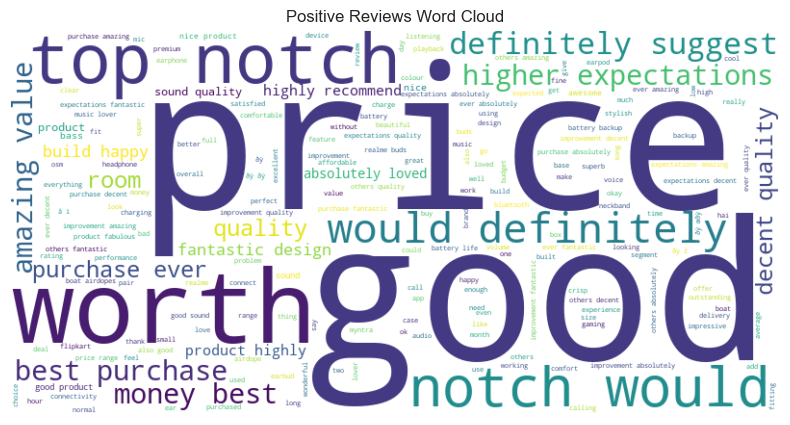

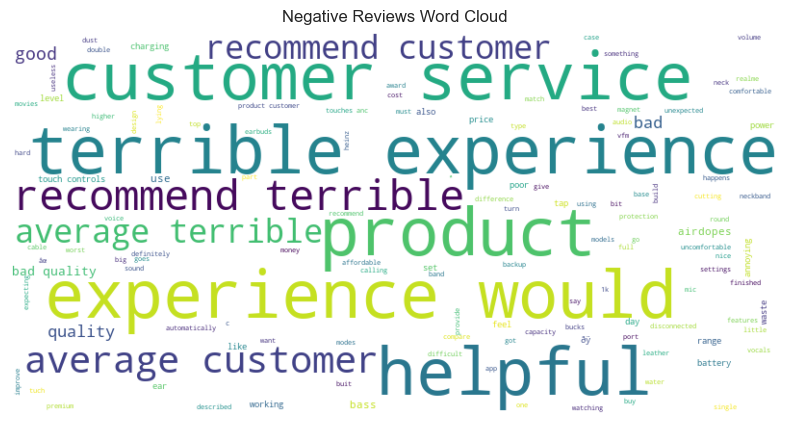

Topic 1:  quality product expectations purchase best
Topic 2:  good price quality product sound


C:\Users\Krishna Singh\AppData\Local\Temp\ipykernel_45484\2954389102.py:77: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




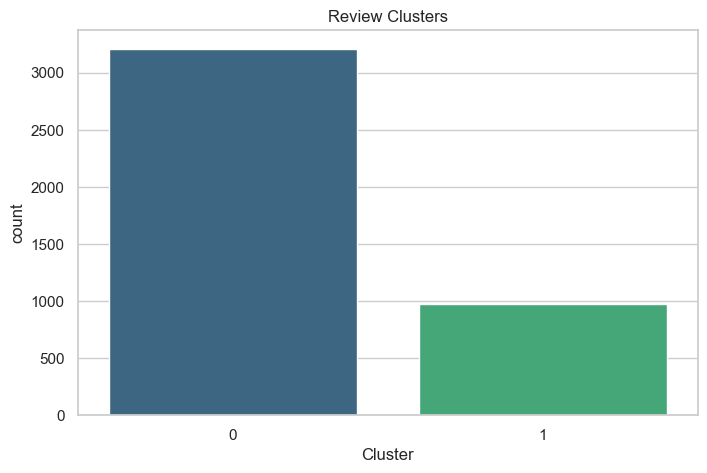

Analysis complete! 


In [70]:
!pip install wordcloud
!pip install textblob
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.cluster import KMeans
from textblob import TextBlob
import nltk
from nltk.corpus import stopwords
import re

# Download stopwords
nltk.download('stopwords')

# Load the dataset
df = pd.read_csv('boat_scrap.csv')

# Data Cleaning
def clean_text(text):
    text = re.sub(r'\W+', ' ', str(text))  # Remove special characters
    text = text.lower()  # Convert to lowercase
    return text

df["Cleaned_Review"] = df["reviews"].apply(clean_text)

# Sentiment Analysis
def get_sentiment(text):
    analysis = TextBlob(text)
    if analysis.sentiment.polarity > 0:
        return "Positive"
    elif analysis.sentiment.polarity < 0:
        return "Negative"
    else:
        return "Neutral"

df["Sentiment"] = df["Cleaned_Review"].apply(get_sentiment)

# Separate positive and negative reviews
positive_reviews = df[df["Sentiment"] == "Positive"]["Cleaned_Review"]
negative_reviews = df[df["Sentiment"] == "Negative"]["Cleaned_Review"]

# Generate Word Clouds
def generate_wordcloud(text, title):
    wordcloud = WordCloud(width=800, height=400, background_color="white", stopwords=set(stopwords.words("english"))).generate(" ".join(text))
    plt.figure(figsize=(10,5))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(title)
    plt.show()

generate_wordcloud(positive_reviews, "Positive Reviews Word Cloud")
generate_wordcloud(negative_reviews, "Negative Reviews Word Cloud")

# Topic Modeling (LDA)
vectorizer = CountVectorizer(stop_words="english")
X = vectorizer.fit_transform(df["Cleaned_Review"])
lda = LatentDirichletAllocation(n_components=2, random_state=42)
lda.fit(X)

def display_topics(model, feature_names, num_words=5):
    for idx, topic in enumerate(model.components_):
        print(f"Topic {idx+1}: ", " ".join([feature_names[i] for i in topic.argsort()[:-num_words - 1:-1]]))

display_topics(lda, vectorizer.get_feature_names_out())

# Clustering (KMeans)
num_clusters = 2
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
df["Cluster"] = kmeans.fit_predict(X)

# Visualizing Clusters
plt.figure(figsize=(8, 5))
sns.countplot(x="Cluster", data=df, palette="viridis")
plt.title("Review Clusters")
plt.show()


print("Analysis complete! ")


## Around 2663 rows of data has been scraped by the websites such as   flipkart and myntra
##In the analysis the two topics which have been obtained are :
##Topic 1:  good quality product sound ðÿ
##Topic 2:  nice product awesome earbuds sound
Also the number of positive reviews are more as compared to the negative reviews

In [73]:

import pandas as pd

# Load the dataset
df = pd.read_csv('boat_scrap.csv')


# Display basic information and first few rows
df.info(), df.head()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4189 entries, 0 to 4188
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   name      4128 non-null   object 
 1   dates     4130 non-null   object 
 2   reviews   4121 non-null   object 
 3   ratings   4130 non-null   float64
 4   likes     4130 non-null   float64
 5   dislikes  4130 non-null   float64
dtypes: float64(3), object(3)
memory usage: 196.5+ KB


(None,
                         name       dates  \
 0         sanjay kumar gupta  01-07-2022   
 1  Amirthanraj  Murugaselvam  01-01-2022   
 2            Rashmita Shukla  01-03-2023   
 3            ABHISHEK  KUMAR  06-01-2022   
 4           Saurabh Sisodiya  07-01-2022   
 
                                              reviews  ratings   likes  \
 0  Sound Quality Is Excellent 5⭐⭐⭐⭐⭐\nBass is Out...      4.0  4351.0   
 1  The song in it is so beautiful to listen to an...      5.0  4141.0   
 2                                      Nice product.      5.0  2277.0   
 3  Fabulous in this range 🔥🔥\n\n1. Sound quality ...      5.0  7608.0   
 4  Worth it at this price bass is so deep and ver...      5.0  2185.0   
 
    dislikes  
 0    1625.0  
 1    1320.0  
 2     710.0  
 3    2470.0  
 4     682.0  )

In [75]:
# Drop rows with missing 'reviews' or 'ratings'
df = df.dropna(subset=['reviews', 'ratings'])

# Convert ratings into sentiment labels (1 = Positive, 0 = Negative)
df['sentiment'] = df['ratings'].apply(lambda x: 1 if x >= 4 else (0 if x <= 2 else None))

# Drop neutral reviews (rating = 3)
df = df.dropna(subset=['sentiment'])

# Convert sentiment column to integer type
df['sentiment'] = df['sentiment'].astype(int)

# Check the distribution of sentiment labels
df['sentiment'].value_counts()


sentiment
1    2232
0    1269
Name: count, dtype: int64

In [77]:
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

# Split data into training and test sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(df['reviews'], df['sentiment'], test_size=0.2, random_state=42)

# Convert text to TF-IDF features
vectorizer = TfidfVectorizer(stop_words='english', max_features=5000)
X_train_tfidf = vectorizer.fit_transform(X_train)
X_test_tfidf = vectorizer.transform(X_test)

# Train a Logistic Regression classifier
model = LogisticRegression()
model.fit(X_train_tfidf, y_train)

# Predict on the test set
y_pred = model.predict(X_test_tfidf)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
accuracy


0.6647646219686163

In [79]:
from imblearn.over_sampling import SMOTE
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV

# Apply SMOTE to balance the classes
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_train_tfidf, y_train)

# Train an SVM classifier with hyperparameter tuning
param_grid = {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']}
svm = GridSearchCV(SVC(), param_grid, cv=5, scoring='accuracy')
svm.fit(X_resampled, y_resampled)

# Predict on the test set
y_pred_svm = svm.best_estimator_.predict(X_test_tfidf)

# Calculate accuracy
accuracy_svm = accuracy_score(y_test, y_pred_svm)
svm.best_params_, accuracy_svm


({'C': 10, 'kernel': 'rbf'}, 0.6633380884450785)

In [81]:
# Undersample the majority class to balance the dataset
from sklearn.utils import resample

# Separate positive and negative reviews
df_pos = df[df['sentiment'] == 1]
df_neg = df[df['sentiment'] == 0]

# Undersample positive reviews to match the number of negative reviews
df_pos_downsampled = resample(df_pos, replace=False, n_samples=len(df_neg), random_state=42)

# Combine balanced dataset
df_balanced = pd.concat([df_pos_downsampled, df_neg])

# Split data again after balancing
X_train_bal, X_test_bal, y_train_bal, y_test_bal = train_test_split(df_balanced['reviews'], df_balanced['sentiment'], test_size=0.2, random_state=42)

# Convert text to TF-IDF features
X_train_bal_tfidf = vectorizer.fit_transform(X_train_bal)
X_test_bal_tfidf = vectorizer.transform(X_test_bal)

# Train an SVM classifier
svm_bal = SVC(kernel='linear', C=1)
svm_bal.fit(X_train_bal_tfidf, y_train_bal)

# Predict on the test set
y_pred_bal = svm_bal.predict(X_test_bal_tfidf)

# Calculate accuracy
accuracy_balanced = accuracy_score(y_test_bal, y_pred_bal)
accuracy_balanced

0.7165354330708661

In [83]:
# Re-import the necessary libraries
from sklearn.svm import SVC

# Train an SVM classifier on the balanced dataset
svm_bal = SVC(kernel='linear', C=1)
svm_bal.fit(X_train_bal_tfidf, y_train_bal)

# Predict on the test set
y_pred_bal = svm_bal.predict(X_test_bal_tfidf)

# Calculate accuracy
accuracy_balanced = accuracy_score(y_test_bal, y_pred_bal)
accuracy_balanced


0.7165354330708661